## Import

In [1]:
import os
import sys
import numpy as np
import pandas as pd
from tqdm import tqdm

# add path to get project functions from roots
module_path = os.path.abspath(os.path.join('../../'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
from utils.load_Flame import load_FLAME_csv_params

In [12]:
import matplotlib.pyplot as plt
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:cyan', 'tab:gray']

## Load test data

In [2]:
path = "/Users/michaelstettler/PycharmProjects/BVS/data/AffectNet_FLAME"
test_csv = "flame_validation_params.csv"

df_test = pd.read_csv(os.path.join(path, test_csv), index_col=0)

test_data = load_FLAME_csv_params(df_test)
print("shape test_data[0]", np.shape(test_data[0]))

shape params (4000,)


100%|██████████| 4000/4000 [00:00<00:00, 1456734.91it/s]

shape test_data[0] (4000, 50)


In [3]:
x_test = test_data[0]
y_test = test_data[1]
n_cat = len(np.unique(y_test))
print("shape x_test", np.shape(x_test))
print("shape y_test", np.shape(y_test))
print("n_cat:", n_cat)

shape x_test (4000, 50)
shape y_test (4000,)
n_cat: 8


In [20]:
# compute all means to get reference and tuning directions
cat_means = []
for i in range(n_cat):
    cat_means.append(np.mean(x_test[y_test == i], axis=0))
print("cat_means", np.shape(cat_means))
ref = cat_means[0]
print("ref", np.shape(ref))
tun = np.array(cat_means - ref)
print("tun", np.shape(tun))

cat_means (8, 50)
ref (50,)
tun (8, 50)


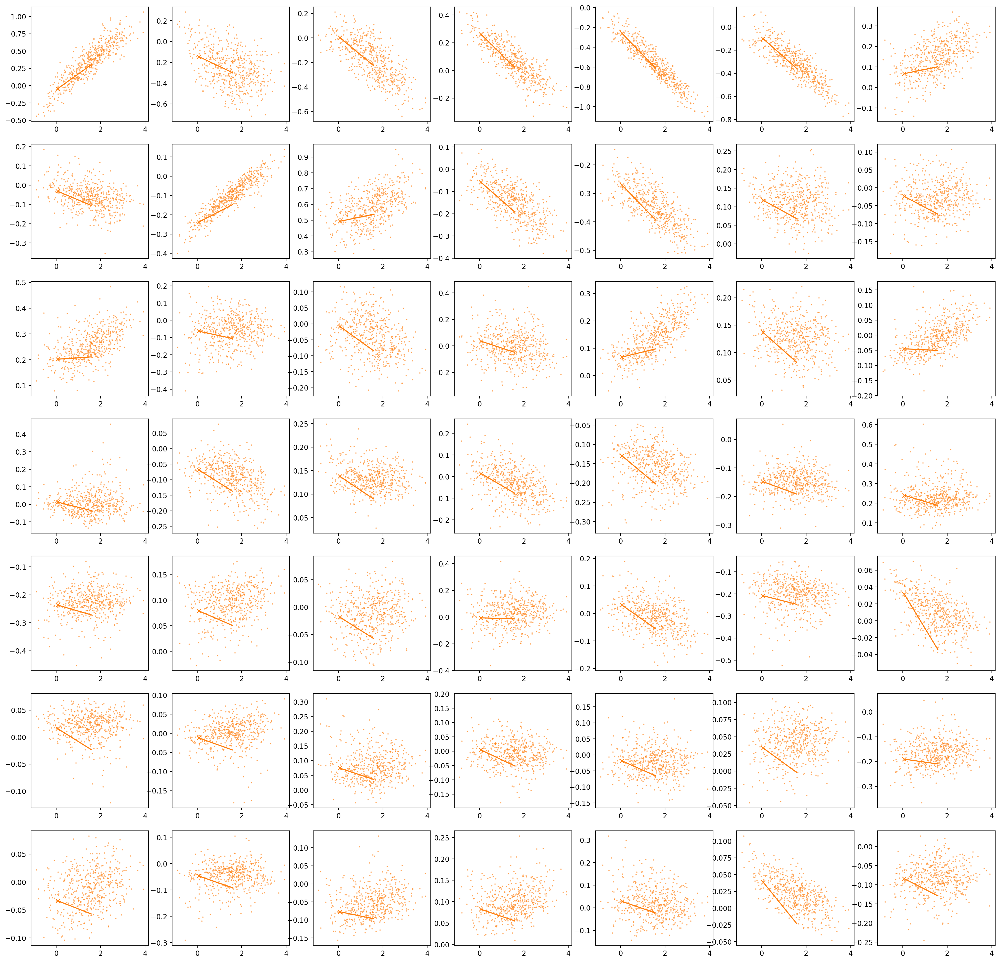

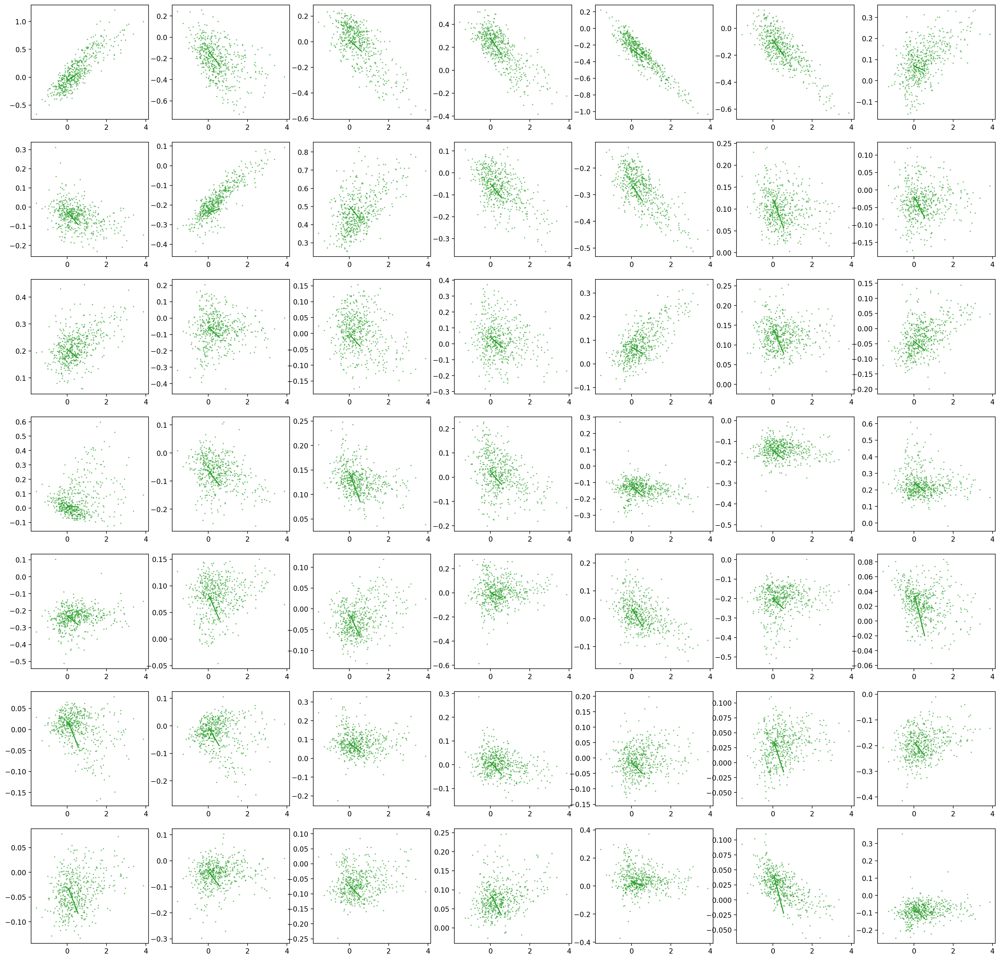

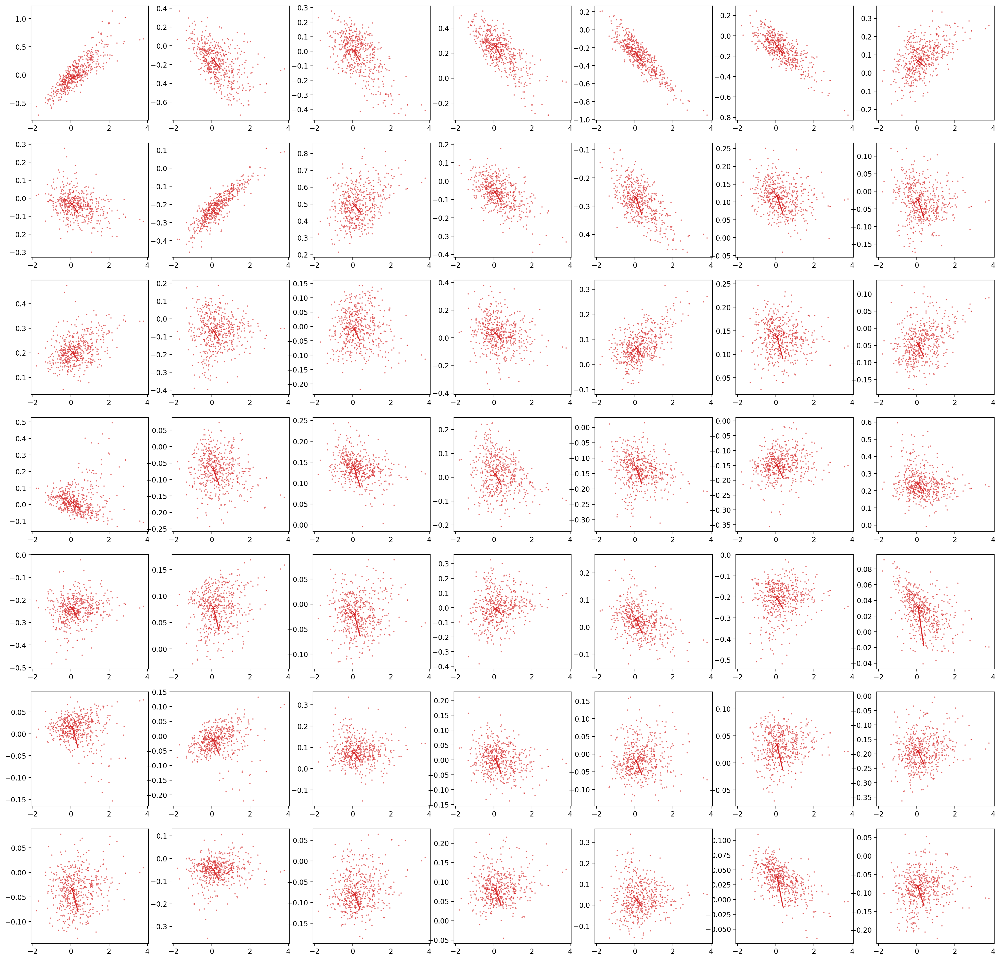

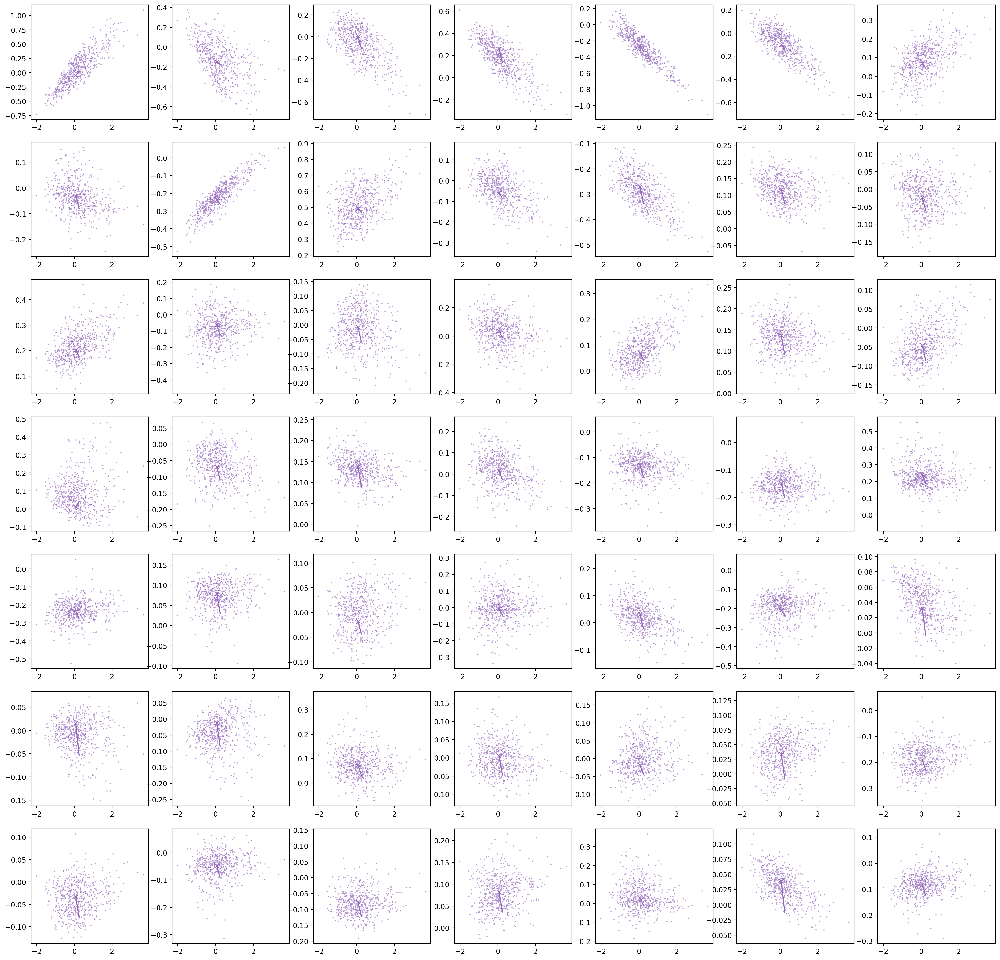

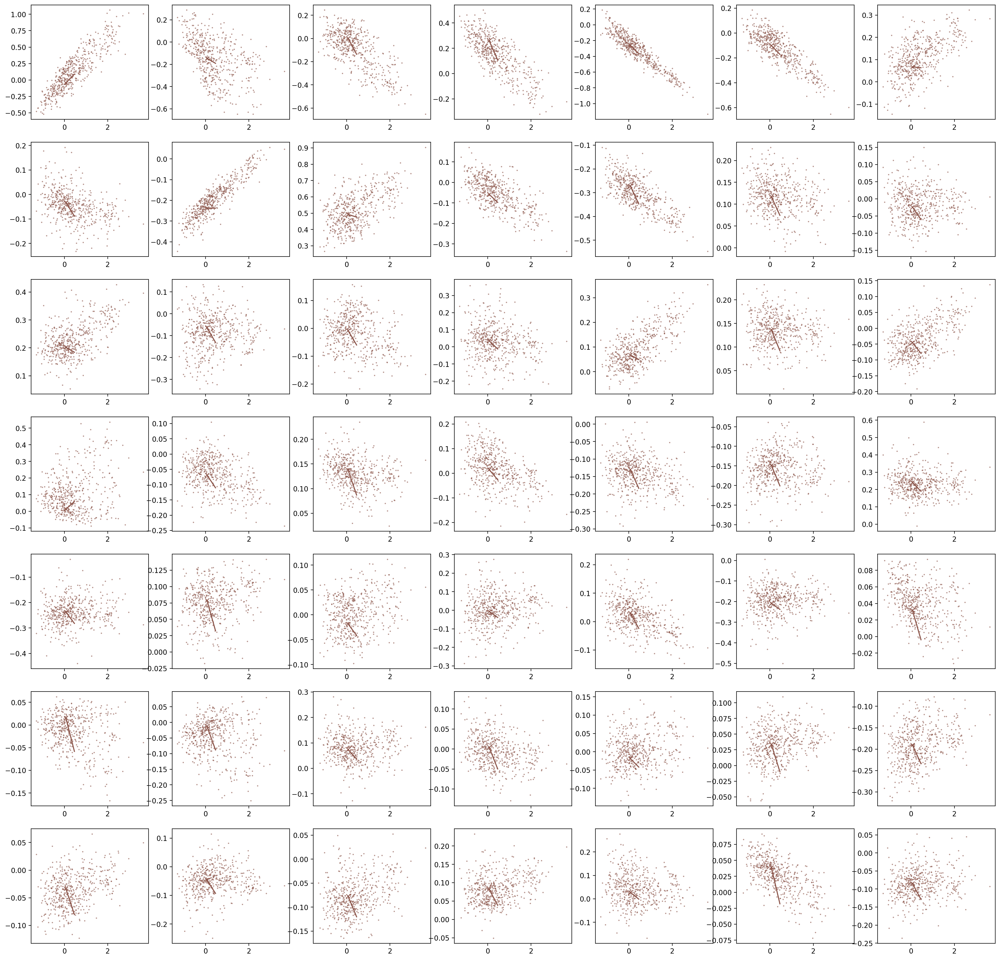

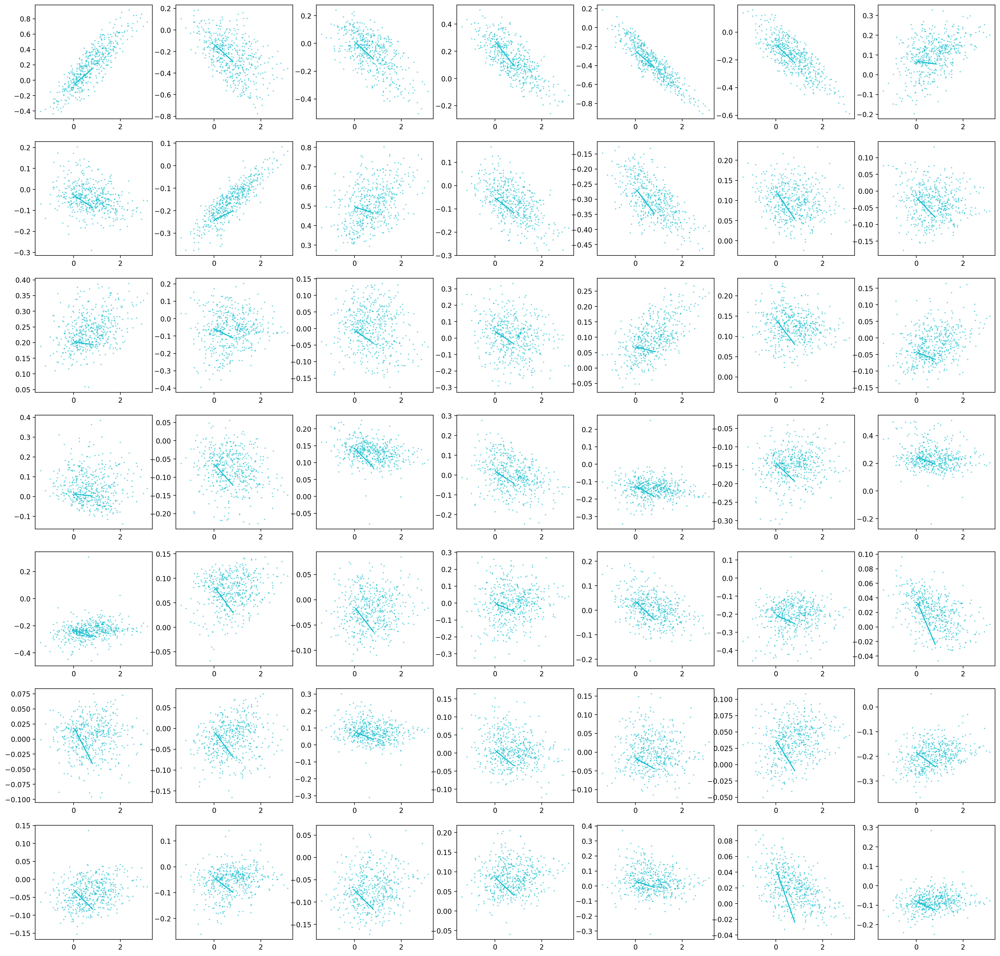

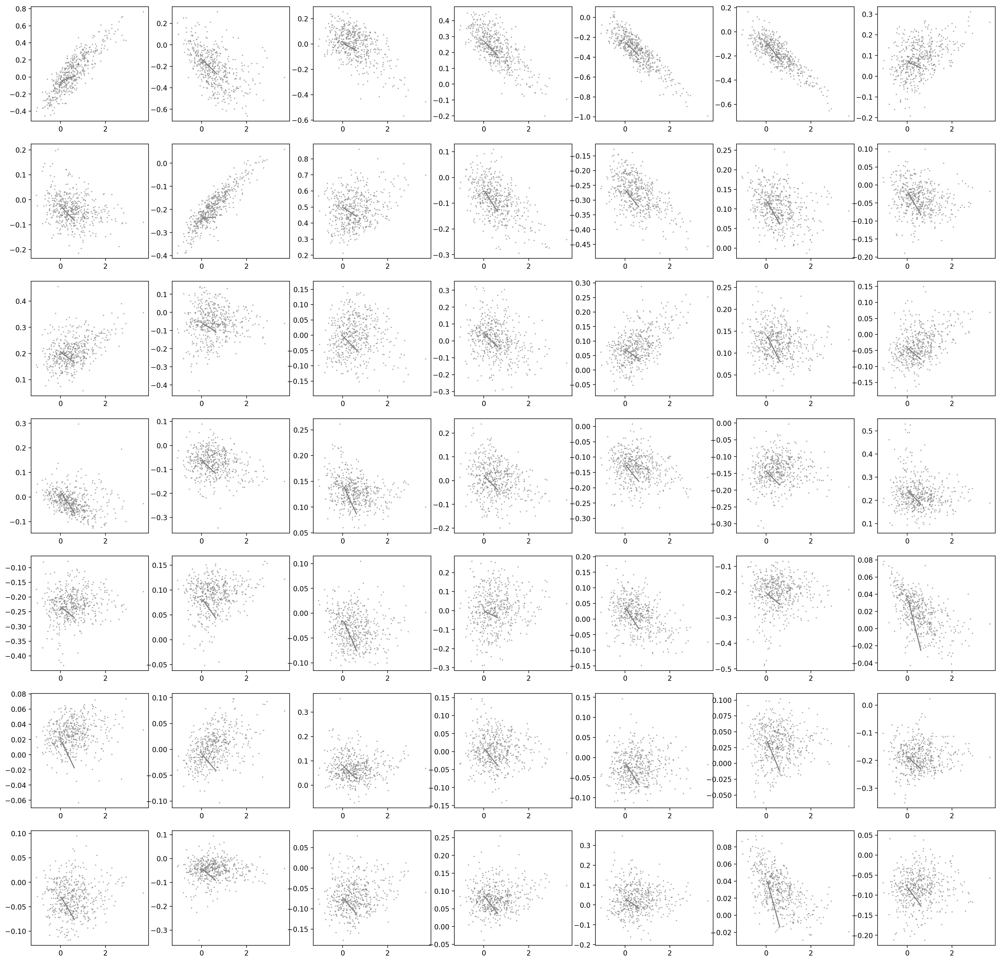

In [23]:
# plot per category
for cat in range(1, n_cat):
    plt.figure(dpi=200, figsize=(25, 25))
    for i in range(7):
        for j in range(7):
            dim = i*7 + j + 1
            plt.subplot(7, 7, dim)
        
            # plot scatter data
            x_ = x_test[y_test == cat]
            plt.scatter(x_[:, 0], x_[:, dim], color=colors[cat], s=1, alpha=.5)
            
            # plot fitted tuning direction
            #plt.plot(cat_means[0, 0], cat_means[0, dim], 'x', color=colors[cat])
            #plt.plot([cat_means[0, 0], cat_means[cat, 0]], [cat_means[0, dim], cat_means[cat, dim]], color=colors[cat])
            plt.plot(ref[0], ref[dim], 'x', color=colors[cat])
            plt.plot([ref[0], tun[cat, 0] + ref[0]], [ref[dim], tun[cat, dim] + ref[1]], color=colors[cat])
    
    #plt.savefig("test_data_FLAME_cat_{}.jpeg".format(cat))

## apply ref-base classfiier

In [24]:
def ref_base_classifier(r, t, x_test, verbose=False):
    # control that tuing vector is a correct size
    if len(np.shape(t)) != 2:
        if len(np.shape(t)) == 1:
            t = np.expand_dims(t, axis=0)
        else:
            print("tuning direction vector is not dim 2!")
            
    # control that tuning vectors and x_test have same dimensions
    if np.shape(t)[1] != np.shape(x_test)[1]:
        raise ValueError("tuning dims and x_test does not have similar dimensions ({} vs. {})".format(np.shape(t)[1], np.shape(x_test)[1]))
    
    # create unity vectors
    t_unit = t / np.repeat(np.expand_dims(np.linalg.norm(t, axis=1), axis=1), np.shape(t)[1], axis=1)
    
    # compute diff from ref
    diff = x_test - r
    
    # compute scalar proj
    proj = x_test @ t_unit.T
    
    if verbose:
        print("proj", np.shape(proj))
        print(proj)
    
    # ReLu activation
    proj[proj < 0] = 0
    
    return proj

In [31]:
def predict(ref, t, x, neutral_cat=4, threshold=1.0):
    # predict test case
    pred = ref_base_classifier(ref, t, x)

    # get all idx that are lower than the threshold
    pred_max = np.amax(pred, axis=1)
    neutral_idx = np.arange(len(pred_max))
    neutral_idx = neutral_idx[pred_max < threshold]

    # retrieve max argument for the category
    pred = np.argmax(pred, axis=1)
    
    # set neutral idx
    pred[neutral_idx] = neutral_cat
    
    return pred

In [32]:
# predict test case
y_pred = predict(ref, tun, x_test, neutral_cat=4, threshold=1.0)
print("y_pred", np.shape(y_pred))
print(y_pred)

y_pred (4000,)
[1 4 4 ... 6 4 6]


In [33]:
# compute accuracy
count_correct = 0
for i, pred in enumerate(y_pred):
    if pred == y_test[i]:
        count_correct += 1
        
print("accuracy:", count_correct/len(y_pred))

accuracy: 0.22975


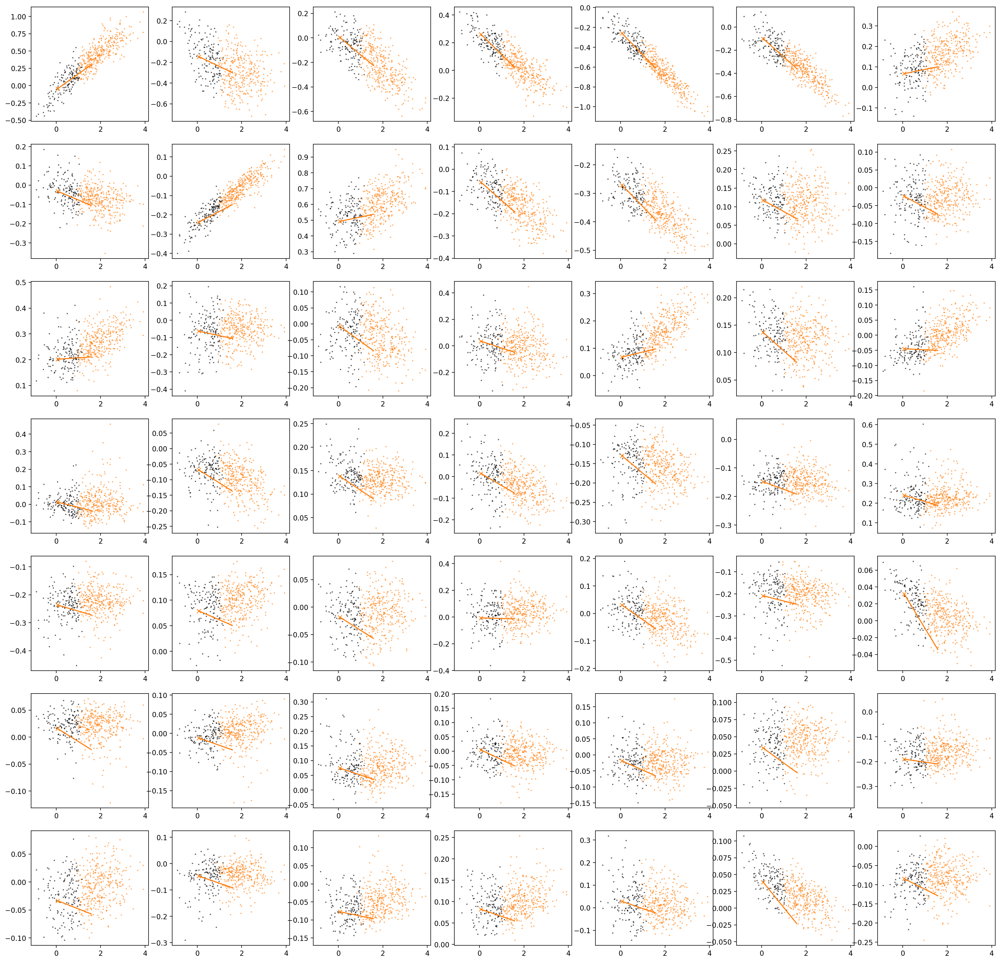

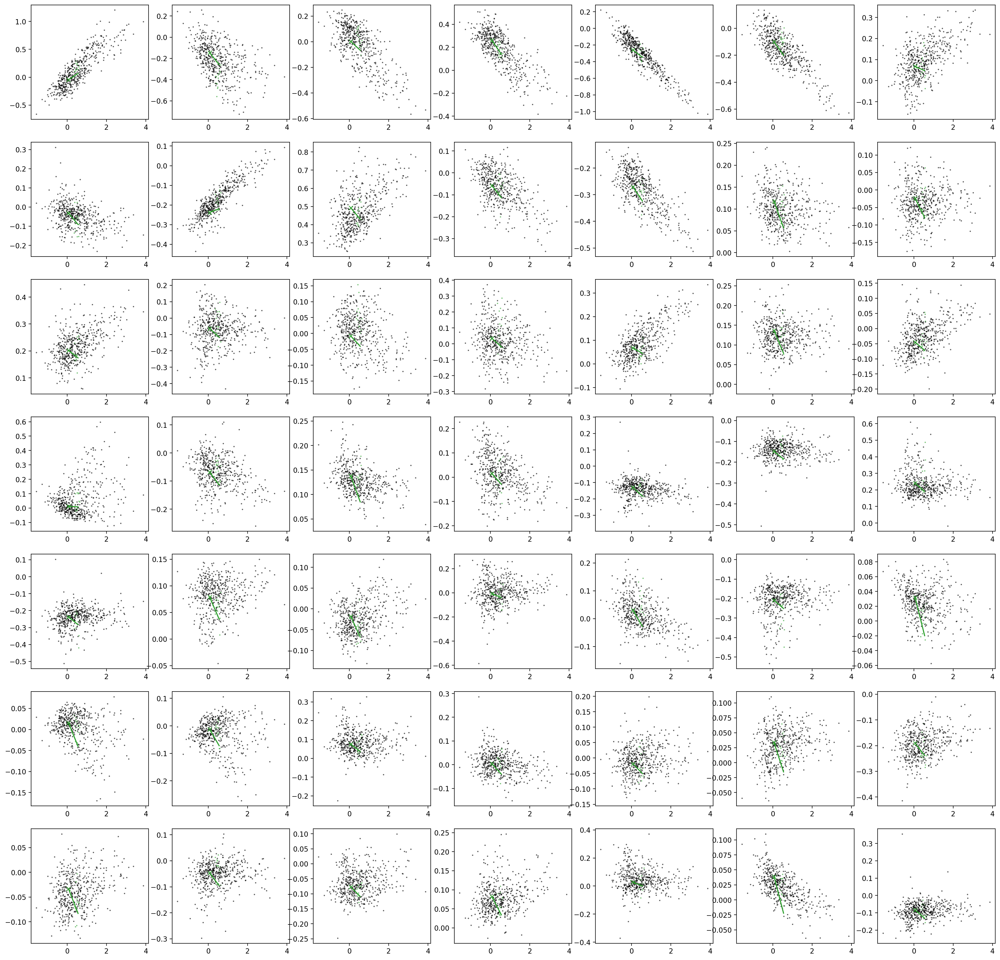

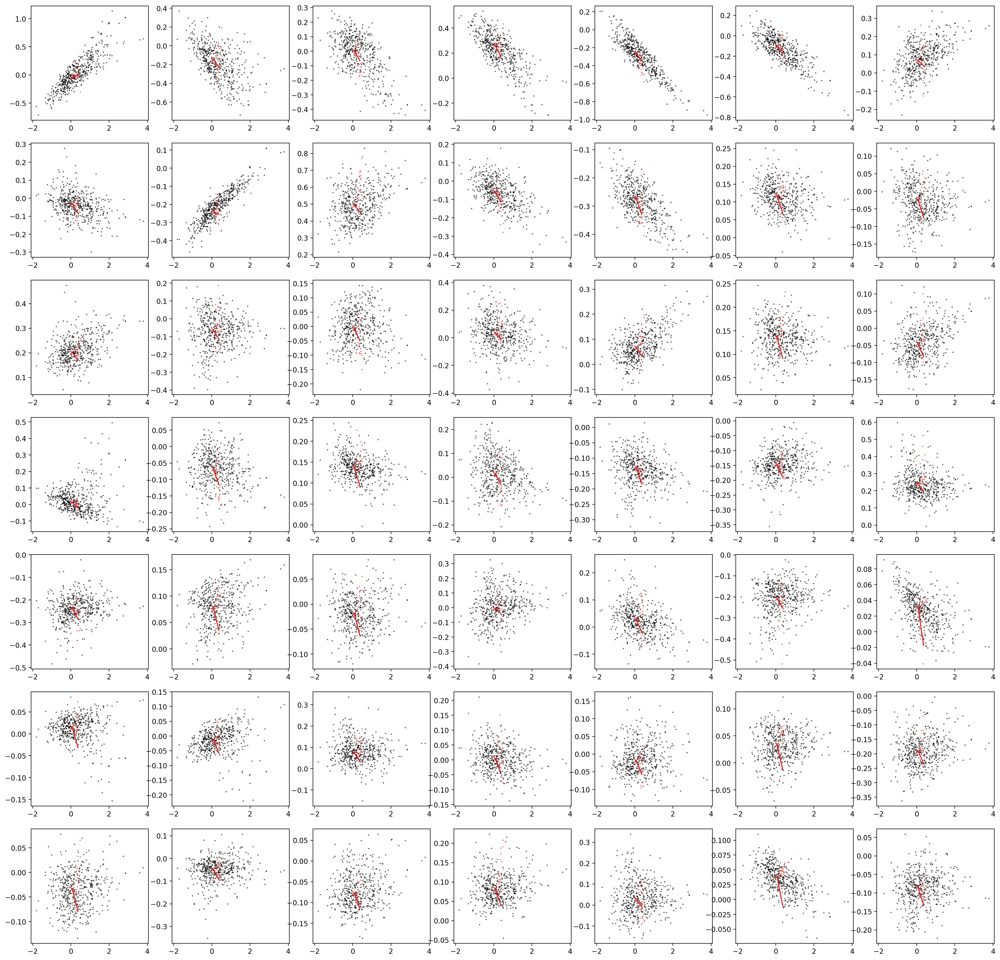

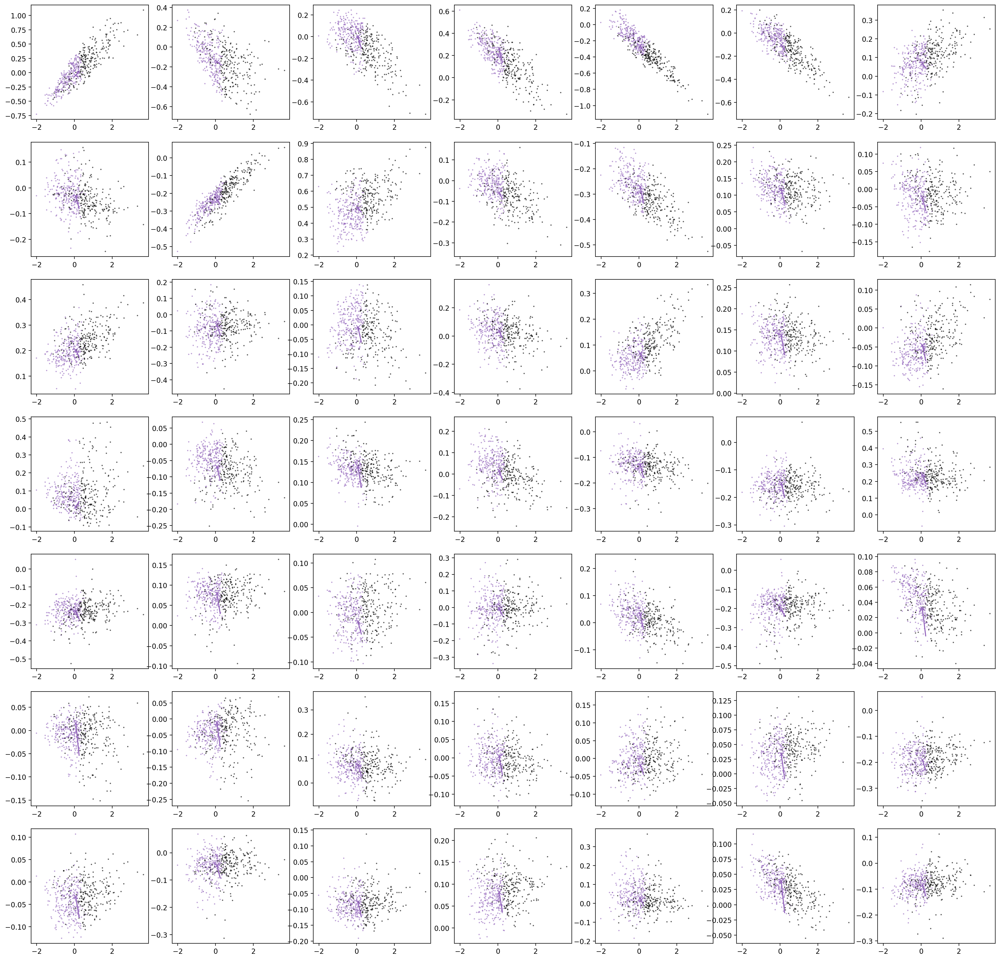

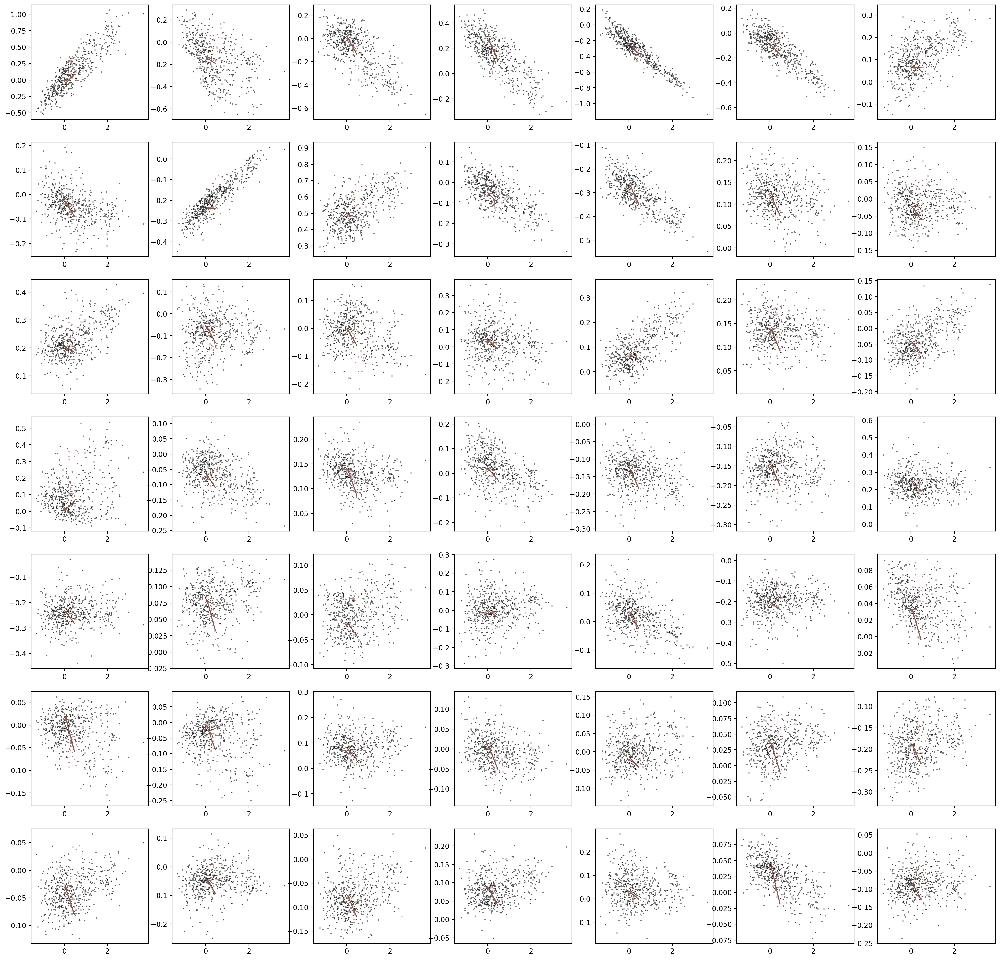

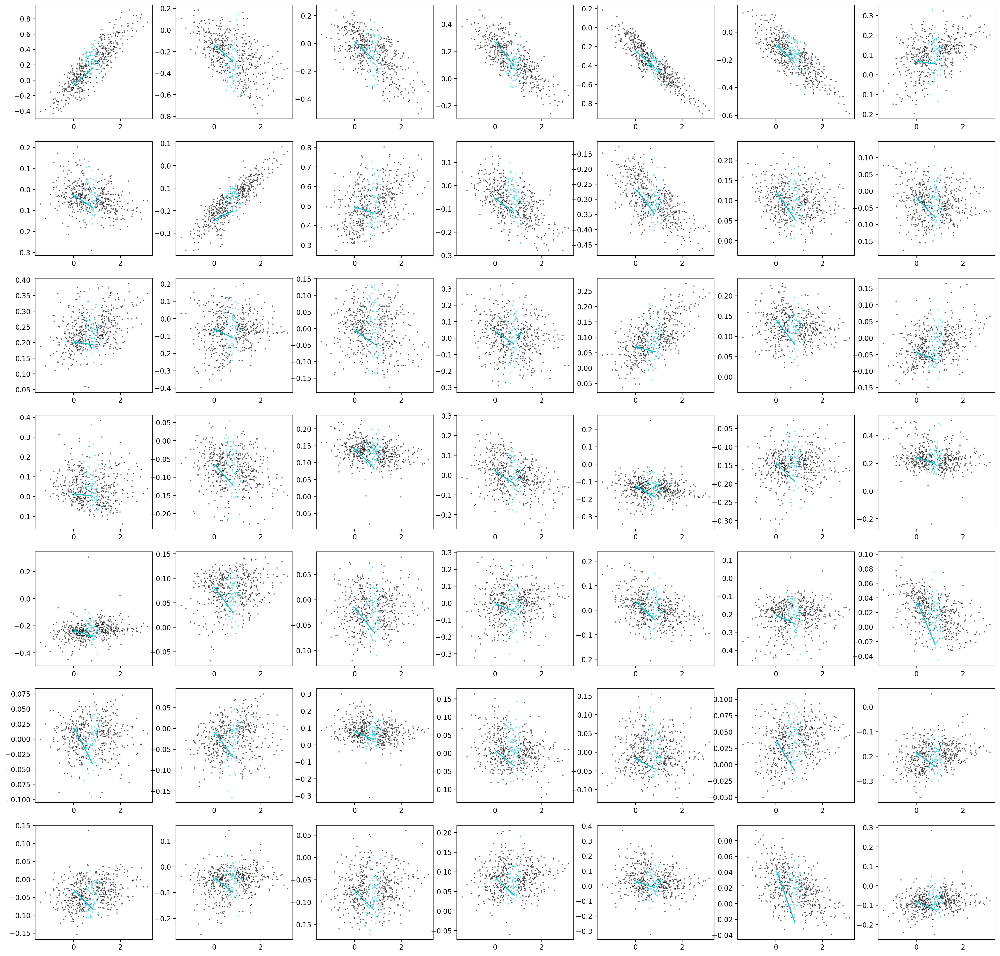

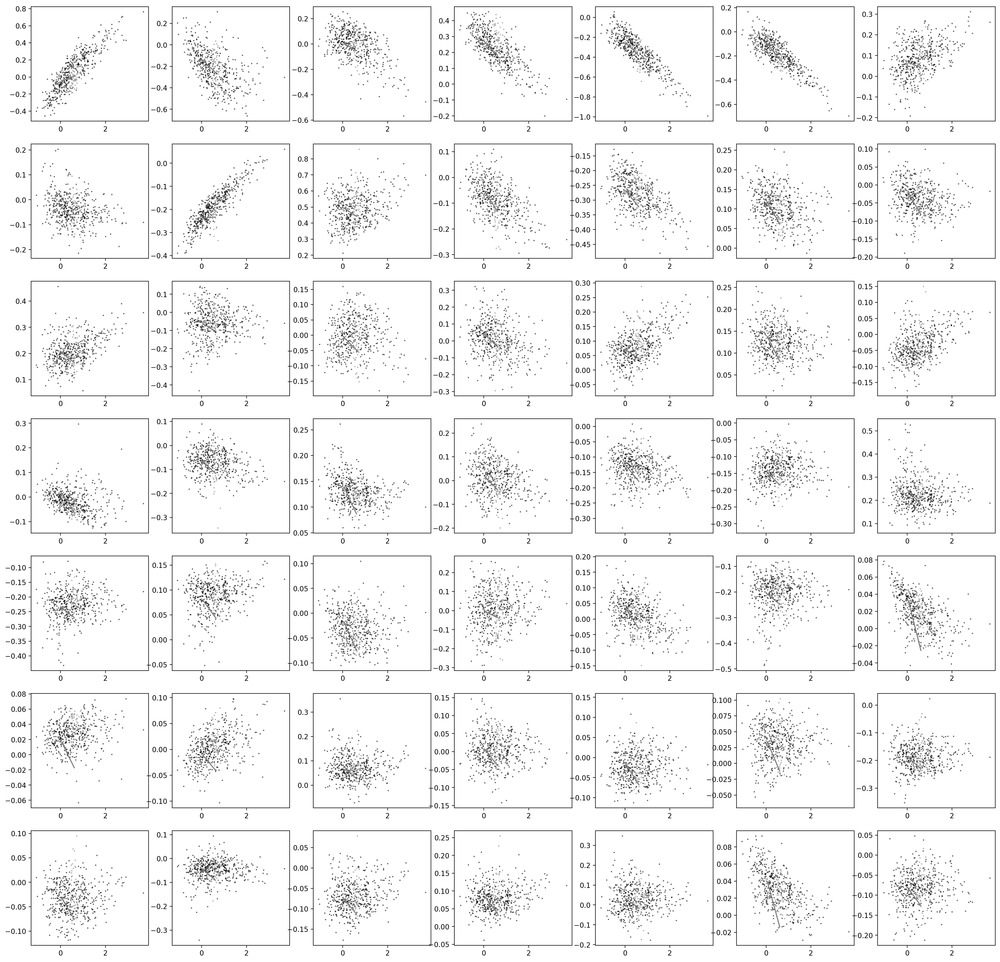

In [38]:
# plot per category
for cat in range(1, n_cat):
    plt.figure(dpi=200, figsize=(25, 25))
    for i in range(7):
        for j in range(7):
            dim = i*7 + j + 1
            plt.subplot(7, 7, dim)
        
            # plot scatter data
            # get all pts for the category
            x_ = x_test[y_test == cat]
            y_pred_cat = y_pred[y_test == cat]
            
            # split between correct and uncorrect trials
            x_correct = x_[y_pred_cat == cat]
            x_wrong = x_[y_pred_cat != cat]
            #print("len x_correct ({}) + x_wrong ({}) = x_ ({}): {}".format(len(x_correct), len(x_wrong), len(x_), len(x_correct) + len(x_wrong) == len(x_)))
            
            # plot correct and uncorrect
            plt.scatter(x_correct[:, 0], x_correct[:, dim], color=colors[cat], s=1, alpha=.5)
            plt.scatter(x_wrong[:, 0], x_wrong[:, dim], color='k', s=1, alpha=.5)
            
            # plot fitted tuning direction
            #plt.plot(cat_means[0, 0], cat_means[0, dim], 'x', color=colors[cat])
            #plt.plot([cat_means[0, 0], cat_means[cat, 0]], [cat_means[0, dim], cat_means[cat, dim]], color=colors[cat])
            plt.plot(ref[0], ref[dim], 'x', color=colors[cat])
            plt.plot([ref[0], tun[cat, 0] + ref[0]], [ref[dim], tun[cat, dim] + ref[1]], color=colors[cat])
    
    #plt.savefig("test_data_FLAME_cat_{}.jpeg".format(cat))